# Problem Statement

In a one-click shopping world with on-demand everything, the life insurance application process is antiquated. Customers provide extensive information to identify risk classification and eligibility, including scheduling medical exams, a process that takes an average of 30 days.

The result? People are turned off. That’s why only 40% of U.S. households own individual life insurance. Prudential wants to make it quicker and less labor intensive for new and existing customers to get a quote while maintaining privacy boundaries.

By developing a predictive model that accurately classifies rirted tosk using a more automated approach, you can greatly impact public perception of the industry.

The results will help Prudential better understand the predictive power of the data points in the existing assessment, enabling us to significantly streamline the process.


## For learning purpose , multiclasss classification has been converted to a two class classification problem

# Problem statement understanding: 

Prudential wants to reduce the turnaround time in approval/quotes for insurance based on the extensive information provided by the customers


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns
import pandas_profiling as pf
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE

from sklearn.preprocessing import LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import train_test_split
from sklearn import ensemble

import pandas_profiling as pp

Using TensorFlow backend.


In [23]:
# Read the data
X_full = pd.read_csv('train.csv', index_col='Id')
X_test_full = pd.read_csv('test.csv', index_col='Id')

#Shape of dataset and sample
print("Shape of Dataset {}".format(X_full.shape))

X_full.head(10)

Shape of Dataset (59381, 127)


,Product_Info_1,Product_Info_2,Product_Info_3,Product_Info_4,Product_Info_5,Product_Info_6,Product_Info_7,Ins_Age,Ht,Wt,...,Medical_Keyword_40,Medical_Keyword_41,Medical_Keyword_42,Medical_Keyword_43,Medical_Keyword_44,Medical_Keyword_45,Medical_Keyword_46,Medical_Keyword_47,Medical_Keyword_48,Response
Id,,,,,,,,,,,,,,,,,,,,,
2,1,D3,10,0.076923,2,1,1,0.641791,0.581818,0.148536,...,0,0,0,0,0,0,0,0,0,8
5,1,A1,26,0.076923,2,3,1,0.059701,0.600000,0.131799,...,0,0,0,0,0,0,0,0,0,4
6,1,E1,26,0.076923,2,3,1,0.029851,0.745455,0.288703,...,0,0,0,0,0,0,0,0,0,8
7,1,D4,10,0.487179,2,3,1,0.164179,0.672727,0.205021,...,0,0,0,0,0,0,0,0,0,8
8,1,D2,26,0.230769,2,3,1,0.417910,0.654545,0.234310,...,0,0,0,0,0,0,0,0,0,8
10,1,D2,26,0.230769,3,1,1,0.507463,0.836364,0.299163,...,0,0,0,0,0,0,0,0,0,8
11,1,A8,10,0.166194,2,3,1,0.373134,0.581818,0.173640,...,0,0,0,0,0,0,0,0,0,8
14,1,D2,26,0.076923,2,3,1,0.611940,0.781818,0.403766,...,0,0,0,0,0,0,0,0,0,1
15,1,D3,26,0.230769,2,3,1,0.522388,0.618182,0.184100,...,0,0,0,0,0,0,0,0,0,8


Unique datatype in Target Variable: int64
Unique values in Target Variable: [8 4 1 6 2 7 3 5]
Total Number of unique values : 8


Text(0.5, 1.0, 'Distribution of rows by response categories')

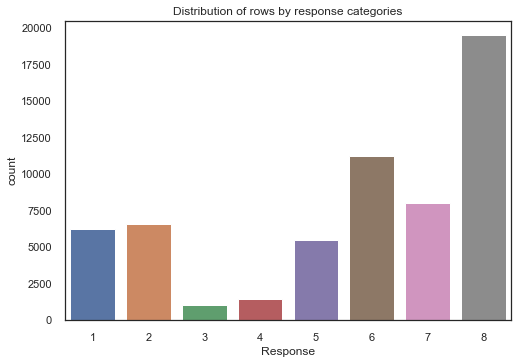

In [24]:
print("Unique datatype in Target Variable: {}".format(X_full.Response.dtype))
print("Unique values in Target Variable: {}".format(X_full.Response.unique()))
print("Total Number of unique values : {}".format(len(X_full.Response.unique())))

#distribution plot for target classes
sns.countplot(x=X_full.Response).set_title('Distribution of rows by response categories')

## Observations from Target variable

1. Majority of data is for Response=8 , followed by 6,7,2
2. Lowest data is for Response=3,followed by 4
3. Response = 1,2,5 show almost same distribution of data
4. Target variable is "Response" and it has 8 classes - out of 8 data seems to be skewed towards class 8


For our exsercise, we will do a binary classification by altering the target variable. The new problem statement would be - Based on the attributes of customers, will the life insurance policy be approved or not i.e.yes(1) or no(0)

As a next step, we will create a new response variable, "Final_Response" in actual dataset

Unique datatype in Target Variable: int64
Unique values in Target Variable: [1 0]
Total Number of unique values : 2


Text(0.5, 1.0, 'Distribution of rows by response categories')

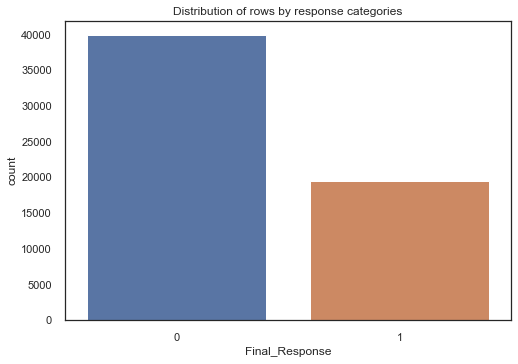

In [26]:
#create a funtion to createa  new target variable based on conditions

def new_target(row):
    if (row['Response']<=7) & (row['Response']>=0):
        val=0
    elif (row['Response']==8):
        val=1
    else:
        val=-1
    return val


#create a copy of original dataset
new_data=X_full.copy()

#create a new column
new_data['Final_Response']=new_data.apply(new_target,axis=1)


#print unique values of target variable
print("Unique datatype in Target Variable: {}".format(new_data.Final_Response.dtype))
print("Unique values in Target Variable: {}".format(new_data.Final_Response.unique()))
print("Total Number of unique values : {}".format(len(new_data.Final_Response.unique())))

#distribution plot for target classes
sns.countplot(x=new_data.Final_Response).set_title('Distribution of rows by response categories')

### Observations after creating new target variable:

1. we have two classes, that is good for our case.
2. Dataset is imbalanced. class-1 has lesser records. This can result in biased classifier towards rejection of insurance application, for business it is a loss.


We might need to de resamplling, below are the common techniques that are used for random, under and over sampling:

1. Random under-sampling
2. Random over-sampling
3. Over-sampling: SMOTE
4. Under-sampling: Tomek links
5. Under-sampling: Cluster Centroids

In [7]:
#drop the actual response column
new_data.drop(axis=1,labels=['Response'],inplace=True)

#rename the "Final_Response" to "Response"
new_data.rename(columns={"Final_Response":"Response"},inplace=True)
#print the nw column names
print("New columns: ", new_data.columns)
X_original=X_full
X_full=new_data

New columns:  Index(['Product_Info_1', 'Product_Info_2', 'Product_Info_3', 'Product_Info_4',
       'Product_Info_5', 'Product_Info_6', 'Product_Info_7', 'Ins_Age', 'Ht',
       'Wt',
       ...
       'Medical_Keyword_40', 'Medical_Keyword_41', 'Medical_Keyword_42',
       'Medical_Keyword_43', 'Medical_Keyword_44', 'Medical_Keyword_45',
       'Medical_Keyword_46', 'Medical_Keyword_47', 'Medical_Keyword_48',
       'Response'],
      dtype='object', length=127)


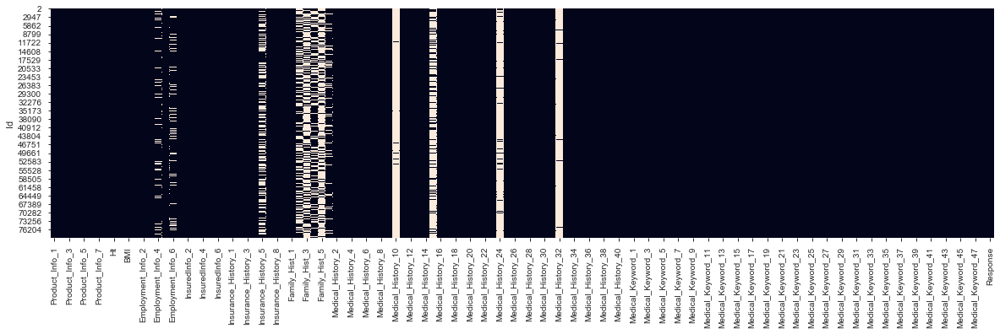

In [8]:
#Are there any columns with missing values?

fig, ax = plt.subplots(figsize=(20,5))  
sns.heatmap(X_full.isnull(), cbar=False)

In [9]:
missing_val_count_by_column = (X_full.isnull().sum()/len(X_full))
print(missing_val_count_by_column[missing_val_count_by_column>0.3].sort_values(ascending=False))

Medical_History_10     0.990620
Medical_History_32     0.981358
Medical_History_24     0.935990
Medical_History_15     0.751015
Family_Hist_5          0.704114
Family_Hist_3          0.576632
Family_Hist_2          0.482579
Insurance_History_5    0.427679
Family_Hist_4          0.323066
dtype: float64


### Observations from missing map and missing percentage:
1. Majority of columns dont have missing values
2. Target variable does not have any missing values
3. Few columns have few missing values, whereas few columns have too much missing values
4. Few medical history, Family_Hist_* columns have more than 30% missing values.

## What are the diffrent datatypes available in datasource

In [10]:
columns_df=pd.DataFrame({'column_names':X_full.columns,'datatypes':X_full.dtypes},index=None)
x=columns_df.groupby(by=['datatypes']).count()
x.reset_index(inplace=True)
x.rename(columns={"column_names":"Number_of_columns"},inplace=True)
lst=[]
for data_type in x.datatypes:
    v=list(X_full.select_dtypes(include=data_type).columns)
    lst.append(v)
    x['Column_Names']=pd.Series(lst)
    
x

,datatypes,Number_of_columns,Column_Names
0,int64,108,"[Product_Info_1, Product_Info_3, Product_Info_..."
1,float64,18,"[Product_Info_4, Ins_Age, Ht, Wt, BMI, Employm..."
2,object,1,[Product_Info_2]


In [11]:
print("Total Unique Values: ", len(X_full['Product_Info_2'].unique()))
print("Unique values in 'Product_Info_2':", X_full['Product_Info_2'].unique())

Total Unique Values:  19
Unique values in 'Product_Info_2': ['D3' 'A1' 'E1' 'D4' 'D2' 'A8' 'A2' 'D1' 'A7' 'A6' 'A3' 'A5' 'C4' 'C1'
 'B2' 'C3' 'C2' 'A4' 'B1']


We have 3 types of columns: int, float, object along with missing values. As a next step, Let's have a closer look at the only object column.

For object columns, generally we use encoding - Label or onehot. However, the choice of encoding depends on the cardinality of the column.Higher cardinality would result in too many columns in case of Onehot encoding. 

In our case we have 19 unique values. On One hot encoding - 19*59k data points would be needed to store the information. We can look at One hot encoding and label encoding as an alternative

# Correlation Plots

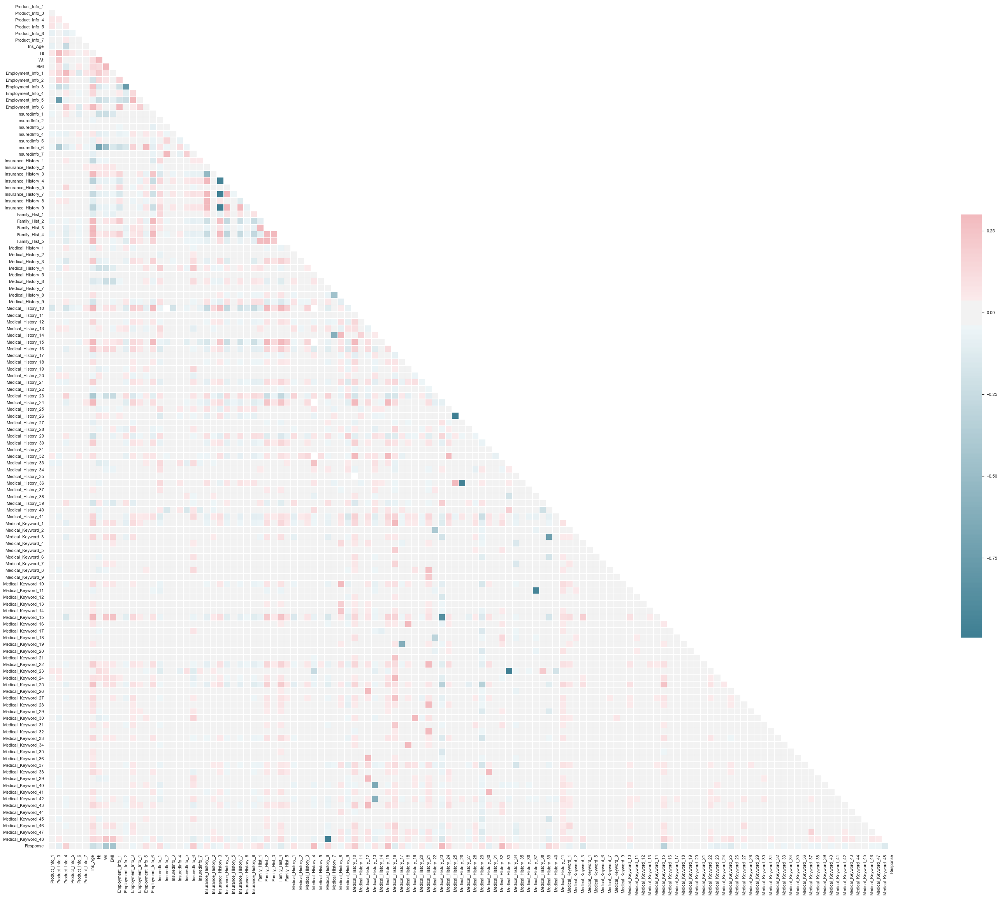

In [12]:
# Compute the correlation matrix
sns.set(style="white")
corr = X_full.corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(60, 40))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

# Observations from correlation plot


1. Maximum correlation is 0.25 indicating absence of linear postive correlation with response variable
2. Ht,Wt,BMI, Ins_Age show negative linear positive correlation with response, indicating as  wt,age and bmi increases the tendency to get a no response increases 

In [13]:
#sns.pairplot(X_full,hue='Response',diag_kind='kde')

# Generating a profile report

In [13]:
#pp.ProfileReport(X_full)

# Check for outliers in age,ht,wt and bmi

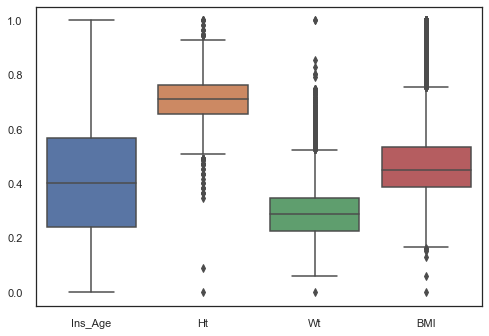

In [14]:
# Exploring Numerical variables
misc_cols=["Ins_Age","Ht","Wt","BMI"]

sns.boxplot(data=X_full[misc_cols])

There are certain outliers for Ht,Wt,BMI. While creating a version of dataset we can remove the outliers

# Building baseline models

In [15]:
y = X_full.Response
X = X_full.drop(labels=['Response'],axis=1)

# Break off validation set from training data
X_train, X_valid, y_train, y_valid = train_test_split(X,y,test_size=.30,random_state=1)

#create train and test dataset after dropping columns with null values and categorical column

#drop categorical column
X_dropped_train=X_train.drop(axis=1,labels=["Product_Info_2"]).copy()
X_dropped_valid=X_valid.drop(axis=1,labels=["Product_Info_2"]).copy()

#drop columns with any null
X_dropped_train.dropna(axis=1,inplace=True)
X_dropped_valid.dropna(axis=1,inplace=True)

# print shape of dataset
print("Shape of X_train dataset {}".format(X_dropped_train.shape))
print("Shape of X_test dataset {}".format(X_dropped_valid.shape))

print("Shape of y_train dataset {}".format(y_train.shape))
print("Shape of y_valid dataset {}".format(y_valid.shape))

Shape of X_train dataset (41566, 112)
Shape of X_test dataset (17815, 112)
Shape of y_train dataset (41566,)
Shape of y_valid dataset (17815,)


In [16]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import SGDClassifier 
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier

from sklearn import ensemble
from sklearn import metrics
from sklearn.metrics import classification_report,recall_score,accuracy_score,precision_score
from sklearn.model_selection import train_test_split

In [17]:
#set seed for same results everytime
seed=0

#declare the models
dt=DecisionTreeClassifier(random_state=seed)
rf=RandomForestClassifier(random_state=seed)
lr=LogisticRegression(random_state=seed)
adb=ensemble.AdaBoostClassifier()
bgc=ensemble.BaggingClassifier()
gbc=ensemble.GradientBoostingClassifier()
xgb=XGBClassifier(random_state=seed)
sgdc=SGDClassifier(random_state=seed)
svc=SVC(random_state=seed)
knn=KNeighborsClassifier()
nb=GaussianNB()

#create a list of models
models=[dt,rf,lr,adb,bgc,gbc,svc,xgb]

def score_model(X_train,y_train,X_valid,y_valid):
    df_columns=[]
    df=pd.DataFrame(columns=df_columns)
    i=0
    #read model one by one
    for model in models:
        model.fit(X_train,y_train)
        y_pred=model.predict(X_valid)
        
        #compute metrics
        train_accuracy=model.score(X_train,y_train)
        test_accuracy=model.score(X_valid,y_valid)
        
        p_score=metrics.precision_score(y_valid,y_pred)
        r_score=metrics.recall_score(y_valid,y_pred)
        f1_score=metrics.f1_score(y_valid,y_pred)
        fp, tp, th = metrics.roc_curve(y_valid, y_pred)
        
        #insert in dataframe
        df.loc[i,"Model_Name"]=model.__class__.__name__
        df.loc[i,"Precision"]=round(p_score,2)
        df.loc[i,"Recall"]=round(r_score,2)
        df.loc[i,"Train_Accuracy"]=round(train_accuracy,2)
        df.loc[i,"Test_Accuracy"]=round(test_accuracy,2)
        df.loc[i,"F1_Score"]=round(f1_score,2)
        df.loc[i,'AUC'] = metrics.auc(fp, tp)
        
        i+=1
    
    #sort values by accuracy
    df.sort_values(by=['F1_Score'],ascending=False,inplace=True)
    return(df)

In [18]:
report_no_null=score_model(X_dropped_train,y_train,X_dropped_valid,y_valid)
report_no_null

c:\users\tsipl1494\appdata\local\continuum\miniconda3\lib\site-packages\sklearn\linear_model\_logistic.py:939: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html.
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)
c:\users\tsipl1494\appdata\local\continuum\miniconda3\lib\site-packages\sklearn\metrics\_classification.py:1268: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


,Model_Name,Precision,Recall,Train_Accuracy,Test_Accuracy,F1_Score,AUC
3,AdaBoostClassifier,0.71,0.76,0.82,0.82,0.73,0.803055
5,GradientBoostingClassifier,0.72,0.74,0.83,0.82,0.73,0.802090
7,XGBClassifier,0.72,0.75,0.83,0.82,0.73,0.804069
1,RandomForestClassifier,0.74,0.71,1.00,0.82,0.72,0.793560
4,BaggingClassifier,0.72,0.65,0.99,0.80,0.68,0.764247
0,DecisionTreeClassifier,0.63,0.63,1.00,0.76,0.63,0.725966
2,LogisticRegression,0.63,0.55,0.75,0.75,0.58,0.694247
6,SVC,0.00,0.00,0.67,0.67,0.00,0.500000


# Observations after scoring 1st data set - No null & No object column

1. AdaBoost, Gradient Boosting and XGB classifier give more than 70% precision and recall
2. Random forest gives highest precision of 74% but 99% train accuracy which could be clear case of overfitting(For learning purpose we will try to hypertune the Random forest parameters)


# We will perform sampling techniques and then evaluate the models again to see which sampling technique perform better

## Random undersampling****

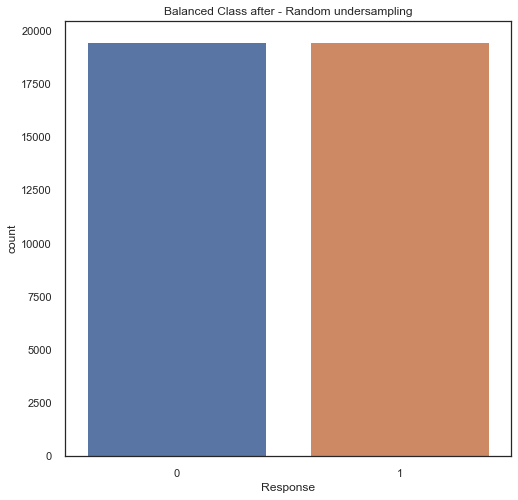

Shape of X_train dataset (31182, 112)
Shape of X_test dataset (17815, 112)
Shape of y_train dataset (31182,)
Shape of y_valid dataset (17815,)


In [19]:
#shuffle the dataset
shuffled_df=X_full.sample(frac=1,random_state=1)

#put all the approved applications in another datset(i.e. 19489)
approved_df=shuffled_df[shuffled_df.Response==1]

#randomly select same number of unapproved applications as approved
non_approved_df=shuffled_df[shuffled_df.Response==0].sample(n=len(approved_df),random_state=1)

#concatenate both dataframes
normalized_df=pd.concat([approved_df,non_approved_df])

#plot the dataset after sampling
plt.figure(figsize=(8,8))
sns.countplot(data=normalized_df,x='Response')
plt.title("Balanced Class after - Random undersampling")
plt.show()


#Split the normalized_dataset into train test.
norm_y = normalized_df.Response
norm_X = normalized_df.drop(labels=['Response'],axis=1)

# Break off validation set from training data
norm_X_train,norm_X_valid, norm_y_train, norm_y_valid = train_test_split(norm_X,norm_y,test_size=.20,random_state=1)

#create train and test dataset after dropping columns with null values and categorical column

#drop categorical column
norm_X_dropped_train=norm_X_train.drop(axis=1,labels=["Product_Info_2"]).copy()
norm_X_dropped_valid=X_valid.drop(axis=1,labels=["Product_Info_2"]).copy()

#drop columns with any null
norm_X_dropped_train.dropna(axis=1,inplace=True)
norm_X_dropped_valid.dropna(axis=1,inplace=True)

# print shape of dataset
print("Shape of X_train dataset {}".format(norm_X_dropped_train.shape))
print("Shape of X_test dataset {}".format(norm_X_dropped_valid.shape))

print("Shape of y_train dataset {}".format(norm_y_train.shape))
print("Shape of y_valid dataset {}".format(y_valid.shape))

In [20]:
# Undersampled Dataset report
undersample_report=score_model(norm_X_dropped_train,norm_y_train,norm_X_dropped_valid,y_valid)
undersample_report

c:\users\tsipl1494\appdata\local\continuum\miniconda3\lib\site-packages\sklearn\linear_model\_logistic.py:939: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html.
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


,Model_Name,Precision,Recall,Train_Accuracy,Test_Accuracy,F1_Score,AUC
1,RandomForestClassifier,0.79,0.97,1.00,0.90,0.87,0.921046
4,BaggingClassifier,0.79,0.95,0.99,0.90,0.86,0.912004
0,DecisionTreeClassifier,0.75,0.95,1.00,0.88,0.84,0.896676
5,GradientBoostingClassifier,0.66,0.87,0.83,0.81,0.75,0.822637
7,XGBClassifier,0.65,0.87,0.83,0.81,0.75,0.822091
3,AdaBoostClassifier,0.64,0.88,0.82,0.80,0.74,0.819035
2,LogisticRegression,0.54,0.82,0.74,0.72,0.65,0.742247
6,SVC,0.46,0.40,0.59,0.65,0.43,0.584529


## SMOTE

In [21]:
from imblearn.over_sampling import SMOTE


#take original X_train,y_train, X_valid and y_valid and then perform set of operation on X_train 

sm=SMOTE(sampling_strategy='minority',random_state=1)

over_X_train=X_train.drop(axis=1,labels=["Product_Info_2"]).copy()
over_X_valid=X_valid.drop(axis=1,labels=["Product_Info_2"]).copy()

#drop columns with any null
over_X_train.dropna(axis=1,inplace=True)
over_X_valid.dropna(axis=1,inplace=True)

names=over_X_train.columns

#fit the model and generate the dataset
oversample_X_train,oversample_y_train=sm.fit_sample(over_X_train,y_train)

oversample_X_train=pd.DataFrame(oversample_X_train,columns=names)
oversample_X_train.head()

# print shape of dataset
print("Shape of X_train dataset {}".format(oversample_X_train.shape))
print("Shape of X_test dataset {}".format(over_X_valid.shape))

print("Shape of y_train dataset {}".format(oversample_y_train.shape))
print("Shape of y_valid dataset {}".format(y_valid.shape))

Shape of X_train dataset (55840, 112)
Shape of X_test dataset (17815, 112)
Shape of y_train dataset (55840,)
Shape of y_valid dataset (17815,)


In [22]:
# Undersampled Dataset report
oversample_report=score_model(oversample_X_train,oversample_y_train,over_X_valid,y_valid)
oversample_report

/opt/conda/lib/python3.6/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning: Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.
  FutureWarning)
/opt/conda/lib/python3.6/site-packages/sklearn/svm/base.py:193: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


,Model_Name,Precision,Recall,Train_Accuracy,Test_Accuracy,F1_Score,AUC
5,GradientBoostingClassifier,0.70,0.78,0.86,0.82,0.74,0.809852
7,XGBClassifier,0.70,0.78,0.86,0.82,0.74,0.810367
3,AdaBoostClassifier,0.67,0.80,0.85,0.80,0.73,0.803498
2,LogisticRegression,0.65,0.82,0.82,0.79,0.72,0.801000
1,RandomForestClassifier,0.73,0.65,0.99,0.81,0.69,0.765134
4,BaggingClassifier,0.71,0.66,0.99,0.80,0.69,0.765999
0,DecisionTreeClassifier,0.63,0.65,1.00,0.76,0.64,0.734135
6,SVC,0.54,0.79,0.80,0.71,0.64,0.729104


# Comparison report from all 3 runs

In [23]:
print("=========================================No_null_random_sampling====================================")
report_no_null.sort_values(by=['F1_Score'],ascending=False,inplace=True)
report_no_null

=========================================No_null_random_sampling====================================


,Model_Name,Precision,Recall,Train_Accuracy,Test_Accuracy,F1_Score,AUC
3,AdaBoostClassifier,0.71,0.76,0.82,0.82,0.73,0.803055
5,GradientBoostingClassifier,0.72,0.74,0.83,0.82,0.73,0.802090
7,XGBClassifier,0.72,0.75,0.83,0.82,0.73,0.804069
2,LogisticRegression,0.73,0.68,0.81,0.81,0.70,0.775104
1,RandomForestClassifier,0.74,0.63,0.99,0.81,0.68,0.759940
4,BaggingClassifier,0.72,0.64,0.99,0.80,0.68,0.758190
0,DecisionTreeClassifier,0.63,0.63,1.00,0.76,0.63,0.725966
6,SVC,0.66,0.45,0.77,0.74,0.53,0.667964


In [24]:
print("=========================================random_undersampling====================================")
undersample_report.sort_values(by=['F1_Score'],ascending=False,inplace=True)
undersample_report

=========================================random_undersampling====================================


,Model_Name,Precision,Recall,Train_Accuracy,Test_Accuracy,F1_Score,AUC
1,RandomForestClassifier,0.79,0.95,0.99,0.90,0.86,0.914445
4,BaggingClassifier,0.79,0.95,0.99,0.90,0.86,0.913706
0,DecisionTreeClassifier,0.75,0.95,1.00,0.88,0.84,0.896676
5,GradientBoostingClassifier,0.66,0.87,0.83,0.81,0.75,0.822637
7,XGBClassifier,0.65,0.87,0.83,0.81,0.75,0.822091
3,AdaBoostClassifier,0.64,0.88,0.82,0.80,0.74,0.819035
2,LogisticRegression,0.64,0.84,0.81,0.79,0.73,0.805908
6,SVC,0.53,0.84,0.76,0.71,0.65,0.739474


In [25]:
print("=========================================SMOTE_upsampling====================================")
oversample_report.sort_values(by=['F1_Score'],ascending=False,inplace=True)
oversample_report

=========================================SMOTE_upsampling====================================


,Model_Name,Precision,Recall,Train_Accuracy,Test_Accuracy,F1_Score,AUC
5,GradientBoostingClassifier,0.70,0.78,0.86,0.82,0.74,0.809852
7,XGBClassifier,0.70,0.78,0.86,0.82,0.74,0.810367
3,AdaBoostClassifier,0.67,0.80,0.85,0.80,0.73,0.803498
2,LogisticRegression,0.65,0.82,0.82,0.79,0.72,0.801000
1,RandomForestClassifier,0.73,0.65,0.99,0.81,0.69,0.765134
4,BaggingClassifier,0.71,0.66,0.99,0.80,0.69,0.765999
0,DecisionTreeClassifier,0.63,0.65,1.00,0.76,0.64,0.734135
6,SVC,0.54,0.79,0.80,0.71,0.64,0.729104


# Observations from diffrent sampling techniques


## Choosing the sampling technique:

Undersampling reduces the number of records where as Oversampling creates synthetic records to increase the minority class. - This will make model generalize well

**Sampling technique for data prepration ** :
* SMOTE as it should help in generalization by use of synthetic samples

## Choosing the models:

1. We are aiming for precision and want to make sure business identifies the right people to give insurance.Out of no null, under over - Random forest performance is stable but it overfits(can be controlled by hyper parameter tuning)
2. XGBoost and Gradientboosting perform simple interms of F1_score,P & R and consitently perform similar independent of sampling method.

**Two models** : 
1. Random Forest for learning purpose and avoiding overfitting
2. XGBClassifier

# Preparing dataset for Model:

We will prepare a new dataset with below operations performed:
1. Outlier Treatment for wt,bmi,Ht
2. Product_info_2 column encoded
3. Combining all the keywords into single columns

# Step1 : Remove Outliers based on IQR range

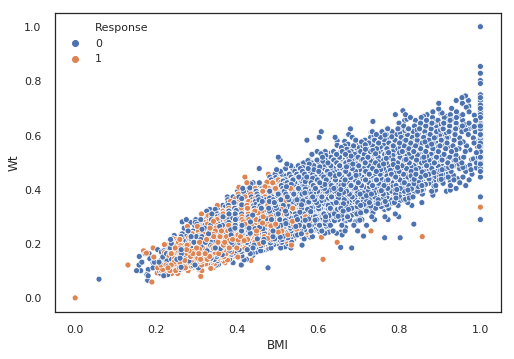

In [26]:
# sns.scatterplot(data=X_full,x='BMI',y='Wt',hue='Response',alpha=1)
# normalized_df
sns.scatterplot(data=X_full,x='BMI',y='Wt',hue='Response',alpha=1)

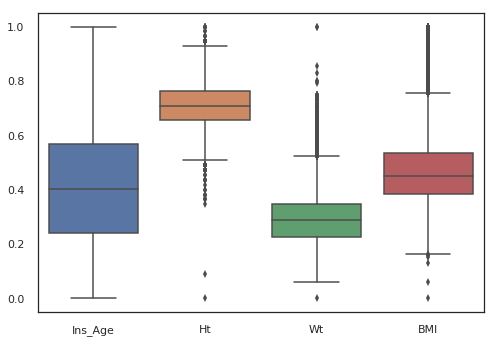

In [27]:
misc_cols=["Ins_Age","Ht","Wt","BMI"]

sns.boxplot(data=X_full[misc_cols])

In [28]:
def remove_outlier(df, col_names):
    df_in=df
    for col_name in col_names:
        q1 = df_in[col_name].quantile(0.25)
        q3 = df_in[col_name].quantile(0.75)
        iqr = q3-q1 #Interquartile range
        fence_low  = q1-1.5*iqr
        fence_high = q3+1.5*iqr
        df_out = df_in.loc[(df_in[col_name] > fence_low) & (df_in[col_name] < fence_high)]
        df_in=df_out
    return df_in

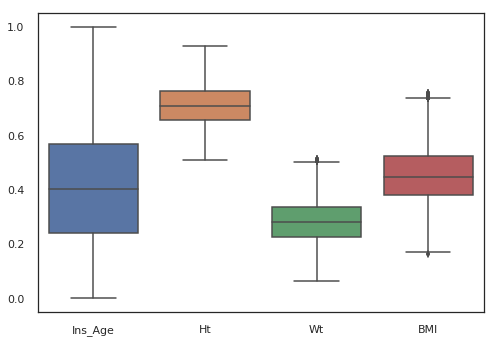

In [29]:
dev=remove_outlier(X_full,['BMI','Wt','Ht'])
sns.boxplot(data=dev[misc_cols])

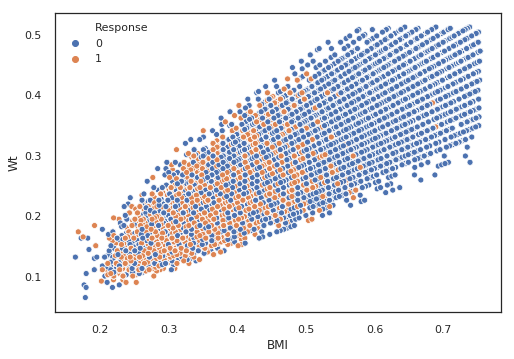

In [30]:
sns.scatterplot(data=dev,x='BMI',y='Wt',hue='Response',alpha=1)

# Perform smote and prep data

In [31]:
from imblearn.over_sampling import SMOTE

#use actual  train test split and perform below steps:
#Label encoding
OS_X_train=X_train.copy()
OS_X_valid=X_valid.copy()
OS_y_train=y_train.copy()
OS_y_valid=y_valid.copy()


# Step 1: Drop columns with more than 30% missing values

missing_val_count_by_column = (OS_X_train.isnull().sum()/len(OS_X_train))
print(missing_val_count_by_column[missing_val_count_by_column > 0.3])
cols_to_drop=missing_val_count_by_column[missing_val_count_by_column > 0.3].index.values
print("\n\nTotal columns to be dropped: {}".format(len(cols_to_drop)),"\n\nAnd they are: {}".format(cols_to_drop))

# drop the identified columns from train and test dataset
OS_X_train.drop(labels=cols_to_drop,axis=1,inplace=True)
OS_X_valid.drop(labels=cols_to_drop,axis=1,inplace=True)

# Step 2: For less than 30% missing columns perform most frequent missing value treatment
names=OS_X_train.columns.values
imputer=SimpleImputer(strategy="most_frequent")

OS_X_train_clean=pd.DataFrame(data=imputer.fit_transform(OS_X_train),columns=names)
OS_X_valid_clean=pd.DataFrame(data=imputer.fit_transform(OS_X_valid),columns=names)

#Step 3: Create features

#identify all cols with medical keywords
medical_keyword_cols=[col for col in OS_X_train_clean.columns if str(col).startswith("Medical_Keyword")]

#identify all cols with medical history
medical_cols=[col for col in OS_X_train_clean.columns if str(col).startswith("Medical_History")]

OS_X_train_clean['Total_MedKwrds']=OS_X_train_clean[medical_keyword_cols].sum(axis=1)
OS_X_valid_clean['Total_MedKwrds']=OS_X_train_clean[medical_keyword_cols].sum(axis=1)

# Step 4: Create label encoding
le=LabelEncoder()
OS_X_train_clean['Product_Info_2_en'] = le.fit_transform(OS_X_train_clean['Product_Info_2'])
OS_X_valid_clean['Product_Info_2_en'] = le.transform(OS_X_valid_clean['Product_Info_2'])

OS_X_train_clean.drop(axis=1,labels=['Product_Info_2'],inplace=True)
OS_X_valid_clean.drop(axis=1,labels=['Product_Info_2'],inplace=True)


#Step 5: Perform SMOTE

names=OS_X_train_clean.columns
sm=SMOTE(sampling_strategy='minority',random_state=1)
#fit the model and generate the dataset
OS_Final_X_train,OS_Final_y_train=sm.fit_sample(OS_X_train_clean,OS_y_train)

Insurance_History_5    0.428860
Family_Hist_2          0.482173
Family_Hist_3          0.576505
Family_Hist_4          0.321320
Family_Hist_5          0.705336
Medical_History_10     0.990690
Medical_History_15     0.751359
Medical_History_24     0.935115
Medical_History_32     0.980778
dtype: float64


Total columns to be dropped: 9 

And they are: ['Insurance_History_5' 'Family_Hist_2' 'Family_Hist_3' 'Family_Hist_4'
 'Family_Hist_5' 'Medical_History_10' 'Medical_History_15'
 'Medical_History_24' 'Medical_History_32']


In [32]:
X_train=OS_Final_X_train
y_train=OS_Final_y_train
X_valid=OS_X_valid_clean
y_valid=OS_y_valid

# Our Random forest is overfitting, as  a next step will tune the hyper parameters

In [33]:
#evaluate models

def evaluate(model,X_train,y_train,X_valid,y_valid):
    y_pred=model.predict(X_valid)
    #compute metrics
    train_accuracy_rf=model.score(X_train,y_train)
    test_accuracy_rf=model.score(X_valid,y_valid)
    p_score_rf=metrics.precision_score(y_valid,y_pred)
    r_score_rf=metrics.recall_score(y_valid,y_pred)
    f1_score_rf=metrics.f1_score(y_valid,y_pred)
    fp_rf, tp_rf, th_rf = metrics.roc_curve(y_valid, y_pred)
    auc_rf = metrics.auc(fp_rf, tp_rf)
    
    print("Train Accuracy: {}".format(round(train_accuracy_rf,3)))
    print("Test Accuracy: {}".format(round(test_accuracy_rf,3)))
    print("Precision Score: {}".format(round(p_score_rf,3)))
    print("Recall Score: {}".format(round(r_score_rf,3)))
    print("F1 Score: {}".format(round(f1_score_rf,3)))
    print("AUC: {}".format(round(auc_rf,3)))
    
    print("==============Classification Report=============================")
    print(metrics.classification_report(y_valid,y_pred))
    
    print("==============Confusion Matrix=============================")
    print(metrics.confusion_matrix(y_valid,y_pred))
    
    return (r_score_rf,p_score_rf,f1_score_rf,auc_rf,train_accuracy_rf,test_accuracy_rf)

### Basic definitions of the hyperparameters for random forest:

1. **n_estimators** = number of trees in the foreset
2. **max_features** = max number of features considered for splitting a node
3. **max_depth** = max number of levels in each decision tree
4. **min_samples_split** = min number of data points placed in a node before the node is split
5. **min_samples_leaf** = min number of data points allowed in a leaf node
6. **bootstrap** = method for sampling data points (with or without replacement).Whether bootstrap samples are used when building trees. If False, the whole datset is used to build each tree.
7. **classweight**=Weights associated with classes in the form {class_label: weight}. If not given, all classes are supposed to have weight one. For multi-output problems, a list of dicts can be provided in the same order as the columns of y.
8. **criterion**= The function to measure the quality of a split. Supported criteria are “gini” for the Gini impurity and “entropy” for the information gain. Note: this parameter is tree-specific
9. **n_jobs**= Number of jobs to run in parallel
10. **OOb_score**= Whether to use out-of-bag samples to estimate the generalization accuracy.
11. **Random_state**= seed value
12. **Warm_start**=When set to True, reuse the solution of the previous call to fit and add more estimators to the ensemble, otherwise, just fit a whole new forest
13. **min_weight_fraction_leaf**=The minimum weighted fraction of the sum total of weights (of all the input samples) required to be at a leaf node. Samples have equal weight when sample_weight is not provided.
14. **min_impurity_split** = Threshold for early stopping in tree growth. A node will split if its impurity is above the threshold, otherwise it is a leaf
15. **min_impurity_decrease** = A node will be split if this split induces a decrease of the impurity greater than or equal to this value
16. **max_leaf_nodes**=Grow trees with max_leaf_nodes in best-first fashion. Best nodes are defined as relative reduction in impurity. If None then unlimited number of leaf nodes.

In [34]:
rf=RandomForestClassifier(random_state=1)
rf.fit(X_train,y_train)

/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=10,
                       n_jobs=None, oob_score=False, random_state=1, verbose=0,
                       warm_start=False)

In [35]:
evaluate(rf,X_train,y_train,X_valid,y_valid)

Train Accuracy: 0.993
Test Accuracy: 0.798
Precision Score: 0.727
Recall Score: 0.618
F1 Score: 0.668
AUC: 0.752
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.83      0.89      0.86     11972
           1       0.73      0.62      0.67      5843

    accuracy                           0.80     17815
   macro avg       0.78      0.75      0.76     17815
weighted avg       0.79      0.80      0.79     17815

==============Confusion Matrix=============================
[[10616  1356]
 [ 2234  3609]]


(0.6176621598493924,
 0.7268882175226586,
 0.6678386380458919,
 0.7521989382608139,
 0.99253223495702,
 0.7984844232388437)

In [36]:
rf

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=10,
                       n_jobs=None, oob_score=False, random_state=1, verbose=0,
                       warm_start=False)

### Parameters to tune based on above results:
1. n_estimators: As there is no limit on max_depth hence forest is overfitting. As we will control the depth , we would need to increase the number of estimators
2. max_depth: Currently RF is overfitting we will control the depth
3. min_samples_leaf:  currently tree will be build till there 1 value in leaf.Condition for overfitting
4. Bootstarp: Instead of building RF on whole dataset, we will take random sets and train indidvidual trees
4. Min_samples_split: To avoid overfitting we will only split if certain number of records are present in node

In [37]:
# Lets create the parameter grid for tunning Random forest
from pprint import pprint
# Number of trees in random forest
n_estimators = np.arange(20,150,20)
# Maximum number of levels in tree
max_depth = np.arange(5,20,3)
# Minimum number of samples required to split a node
min_samples_split = [20,30,50]
# Minimum number of samples required at each leaf node
min_samples_leaf = [40,50]
# Method of selecting samples for training each tree
bootstrap = [True]


# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': [True]
              }

pprint(random_grid)

{'bootstrap': [True],
 'max_depth': array([ 5,  8, 11, 14, 17]),
 'min_samples_leaf': [40, 50],
 'min_samples_split': [20, 30, 50],
 'n_estimators': array([ 20,  40,  60,  80, 100, 120, 140])}


In [38]:
# Use the random grid to search for best hyperparameters
# First create the base model to tune
rf = RandomForestClassifier()

# Random search of parameters, using 3 fold cross validation, 
# search across 50 different combinations, and use all available cores
rf_random = GridSearchCV(estimator = rf,
                         param_grid=random_grid,
                         #n_iter = 50,
                         cv = 3,
                         verbose=2,
                         scoring='precision',
                         #random_state=42,
                         n_jobs = -1)# Fit the random search model

rf_random.fit(X_train,y_train)

Fitting 3 folds for each of 210 candidates, totalling 630 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed:   38.3s
[Parallel(n_jobs=-1)]: Done 154 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done 357 tasks      | elapsed:  9.3min
[Parallel(n_jobs=-1)]: Done 630 out of 630 | elapsed: 18.9min finished


GridSearchCV(cv=3, error_score='raise-deprecating',
             estimator=RandomForestClassifier(bootstrap=True, class_weight=None,
                                              criterion='gini', max_depth=None,
                                              max_features='auto',
                                              max_leaf_nodes=None,
                                              min_impurity_decrease=0.0,
                                              min_impurity_split=None,
                                              min_samples_leaf=1,
                                              min_samples_split=2,
                                              min_weight_fraction_leaf=0.0,
                                              n_estimators='warn', n_jobs=None,
                                              oob_score=False,
                                              random_state=None, verbose=0,
                                              warm_start=False),
             iid

In [39]:
rf_random.best_estimator_

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=17, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=40, min_samples_split=50,
                       min_weight_fraction_leaf=0.0, n_estimators=120,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [40]:
evaluate(rf_random.best_estimator_, X_train,y_train, X_valid,y_valid)

Train Accuracy: 0.867
Test Accuracy: 0.818
Precision Score: 0.713
Recall Score: 0.746
F1 Score: 0.729
AUC: 0.8
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.87      0.85      0.86     11972
           1       0.71      0.75      0.73      5843

    accuracy                           0.82     17815
   macro avg       0.79      0.80      0.80     17815
weighted avg       0.82      0.82      0.82     17815

==============Confusion Matrix=============================
[[10216  1756]
 [ 1485  4358]]


(0.7458497347253124,
 0.7127903173045469,
 0.7289453876390398,
 0.7995870791902538,
 0.8668696275071633,
 0.8180746561886051)

We have controlled the over fitting and reduced the train accuracy. Lets compare to base model how the new parameters performed

In [41]:
print("\n ==========================Base Model==========================")
model=RandomForestClassifier(random_state=1)
model.fit(X_train,y_train)
base_recall,base_precison,base_f1,base_auc,base_train_accuracy,base_test_accuracy= evaluate(model,X_train,y_train,X_valid,y_valid)


print("\n ==========================Tuned Model==========================")
best_random = rf_random.best_estimator_
randomcv_recall,randomcv_precison,randomcv_f1,randomcv_auc,randomcv_train_accuracy,randomcv_test_accuracy = evaluate(best_random, X_train,y_train, X_valid,y_valid)


print('Gridsearch Improvement in Recall of {:0.2f}%.'.format( 100 * (randomcv_recall - base_recall) / base_recall))
print('Gridsearch Improvement in Precision of {:0.2f}%.'.format( 100 * (randomcv_precison - base_precison) / base_precison))
print('Gridsearch Improvement in F1 Score of {:0.2f}%.'.format( 100 * (randomcv_f1 - base_f1) / base_f1))
print('Gridsearch Improvement in AUC of {:0.2f}%.'.format( 100 * (randomcv_auc - base_auc) / base_auc))
print('Gridsearch Improvement in Train Accuracy of {:0.2f}%.'.format( 100 * (randomcv_train_accuracy - base_train_accuracy) / base_train_accuracy))
print('Gridsearch Improvement in Test Accuracy of {:0.2f}%.'.format( 100 * (randomcv_test_accuracy - base_test_accuracy) / base_test_accuracy))


 ==========================Base Model==========================


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Train Accuracy: 0.993
Test Accuracy: 0.798
Precision Score: 0.727
Recall Score: 0.618
F1 Score: 0.668
AUC: 0.752
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.83      0.89      0.86     11972
           1       0.73      0.62      0.67      5843

    accuracy                           0.80     17815
   macro avg       0.78      0.75      0.76     17815
weighted avg       0.79      0.80      0.79     17815

==============Confusion Matrix=============================
[[10616  1356]
 [ 2234  3609]]

 ==========================Tuned Model==========================
Train Accuracy: 0.867
Test Accuracy: 0.818
Precision Score: 0.713
Recall Score: 0.746
F1 Score: 0.729
AUC: 0.8
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.87      0.85      0.86     11972
           1       0.71      0.75      0.73      5843

In [42]:
from sklearn.metrics import precision_recall_curve

# getting the probabilities of our predictions
random_forest=rf_random.best_estimator_
y_scores = random_forest.predict_proba(X_train)
y_scores = y_scores[:,1]

precision, recall, threshold = precision_recall_curve(y_train, y_scores)

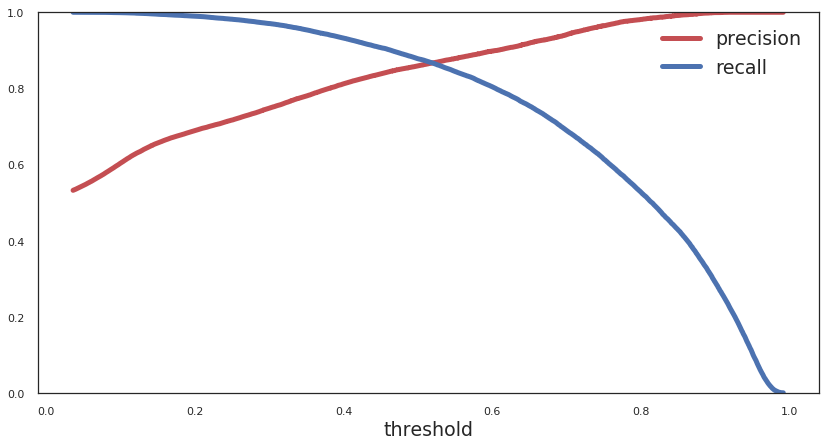

In [43]:
def plot_precision_and_recall(precision, recall, threshold):
    plt.plot(threshold, precision[:-1], "r-", label="precision", linewidth=5)
    plt.plot(threshold, recall[:-1], "b", label="recall", linewidth=5)
    plt.xlabel("threshold", fontsize=19)
    plt.legend(loc="upper right", fontsize=19)
    plt.ylim([0, 1])

plt.figure(figsize=(14, 7))
plot_precision_and_recall(precision, recall, threshold)
plt.show()

In bbove graph we can clearly see that the recall is falling of rapidly at a precision of around 60%. Because of that we may want to select the precision/recall tradeoff before that - maybe at around 80 %.

we can now choose a threshold, that gives you the best precision/recall tradeoff for our current machine learning problem. If we want for example a precision of 80%, we can easily look at the plots and see that you would need a threshold of around 0.5-0.6.Then we could train a model with exactly that threshold and would get the desired accuracy


The same can be seen from the below graph:

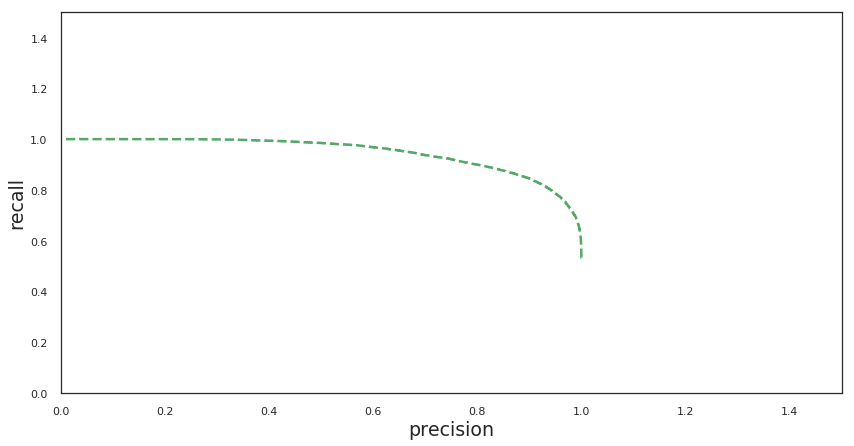

In [44]:
def plot_precision_vs_recall(precision, recall):
    plt.plot(recall, precision, "g--", linewidth=2.5)
    plt.ylabel("recall", fontsize=19)
    plt.xlabel("precision", fontsize=19)
    plt.axis([0, 1.5, 0, 1.5])

plt.figure(figsize=(14, 7))
plot_precision_vs_recall(precision, recall)
plt.show()

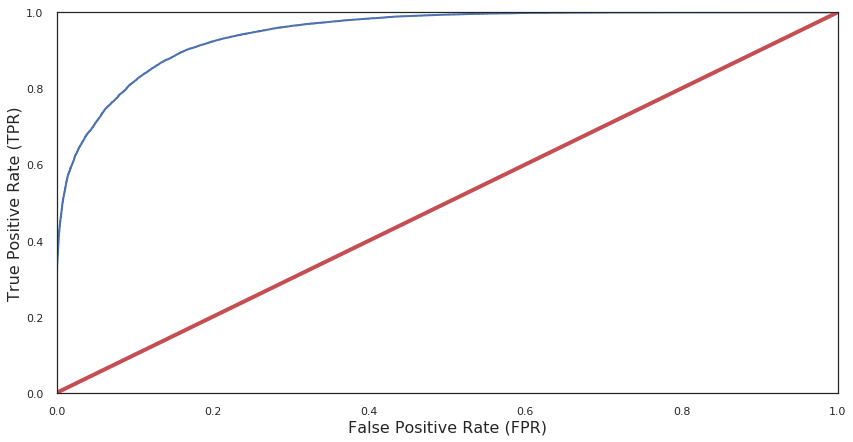

In [45]:
from sklearn.metrics import roc_curve
# compute true positive rate and false positive rate
false_positive_rate, true_positive_rate, thresholds = roc_curve(y_train, y_scores)

# plotting them against each other
def plot_roc_curve(false_positive_rate, true_positive_rate, label=None):
    plt.plot(false_positive_rate, true_positive_rate, linewidth=2, label=label)
    plt.plot([0, 1], [0, 1], 'r', linewidth=4)
    plt.axis([0, 1, 0, 1])
    plt.xlabel('False Positive Rate (FPR)', fontsize=16)
    plt.ylabel('True Positive Rate (TPR)', fontsize=16)

plt.figure(figsize=(14, 7))
plot_roc_curve(false_positive_rate, true_positive_rate)
plt.show()

Using a treshold to retrain a high precision Random forest

In [46]:
y_train_probabilities = random_forest.predict_proba(X_train)
y_test_probabilities = random_forest.predict_proba(X_train)
# y_test_probabilities has shape = [n_samples, n_classes]

y_train_predictions_high_precision = y_train_probabilities[:,1] > 0.55
y_test_predictions_high_precision = y_test_probabilities[:,1] > 0.55

#y_test_predictions_high_recall = y_test_probabilities[:,1] > 0.1

high_P_X_train=X_train[y_train_predictions_high_precision==True]
high_P_y_train=y_train[y_train_predictions_high_precision==True]

high_P_X_valid=X_train[y_train_predictions_high_precision==True]
high_P_y_valid=y_train[y_test_predictions_high_precision==True]

In [47]:
random_forest_high_p=random_forest.fit(high_P_X_train,high_P_y_train)
evaluate(random_forest_high_p,high_P_X_train,high_P_y_train,high_P_X_valid,high_P_y_valid)

Train Accuracy: 0.878
Test Accuracy: 0.878
Precision Score: 0.878
Recall Score: 1.0
F1 Score: 0.935
AUC: 0.5
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.00      0.00      0.00      3266
           1       0.88      1.00      0.94     23580

    accuracy                           0.88     26846
   macro avg       0.44      0.50      0.47     26846
weighted avg       0.77      0.88      0.82     26846

==============Confusion Matrix=============================
[[    0  3266]
 [    0 23580]]


/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


(1.0,
 0.878343142367578,
 0.9352318248522588,
 0.5,
 0.878343142367578,
 0.878343142367578)

## Comparing the enhancement with base model

In [48]:
print("\n ==========================Base Model==========================")
model=RandomForestClassifier(random_state=1)
model.fit(X_train,y_train)
base_recall,base_precison,base_f1,base_auc,base_train_accuracy,base_test_accuracy= evaluate(model,X_train,y_train,X_valid,y_valid)


print("\n ==========================Tuned Model==========================")
high_prcn_recall,high_prcn_precison,high_prcn_f1,high_prcn_auc,high_prcn_train_accuracy,high_prcn_test_accuracy = evaluate(random_forest_high_p,X_train,y_train, X_valid,y_valid)


print('Improvement in Recall @ threshold of 0.55{:0.2f} is %.'.format( 100 * (high_prcn_recall - base_recall) / base_recall))
print('Gridsearch Improvement in Precision @ threshold of 0.55: {:0.2f} %.'.format( 100 * (high_prcn_precison - base_precison) / base_precison))
print('Gridsearch Improvement in F1 Score @ threshold of 0.55: {:0.2f}%.'.format( 100 * (high_prcn_f1 - base_f1) / base_f1))
print('Gridsearch Improvement in AUC of @ threshold of 0.55: {:0.2f}%.'.format( 100 * (high_prcn_auc - base_auc) / base_auc))
print('Gridsearch Improvement in Train @ threshold of 0.55: {:0.2f}%.'.format( 100 * (high_prcn_train_accuracy - base_train_accuracy) / base_train_accuracy))
print('Gridsearch Improvement in Test @ threshold of 0.55: {:0.2f}%.'.format( 100 * (high_prcn_test_accuracy - base_test_accuracy) / base_test_accuracy))


 ==========================Base Model==========================


/opt/conda/lib/python3.6/site-packages/sklearn/ensemble/forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


Train Accuracy: 0.993
Test Accuracy: 0.798
Precision Score: 0.727
Recall Score: 0.618
F1 Score: 0.668
AUC: 0.752
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.83      0.89      0.86     11972
           1       0.73      0.62      0.67      5843

    accuracy                           0.80     17815
   macro avg       0.78      0.75      0.76     17815
weighted avg       0.79      0.80      0.79     17815

==============Confusion Matrix=============================
[[10616  1356]
 [ 2234  3609]]

 ==========================Tuned Model==========================
Train Accuracy: 0.5
Test Accuracy: 0.328
Precision Score: 0.328
Recall Score: 1.0
F1 Score: 0.494
AUC: 0.5
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.00      0.00      0.00     11972
           1       0.33      1.00      0.49      5843

  

/opt/conda/lib/python3.6/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


## Plot feature importance

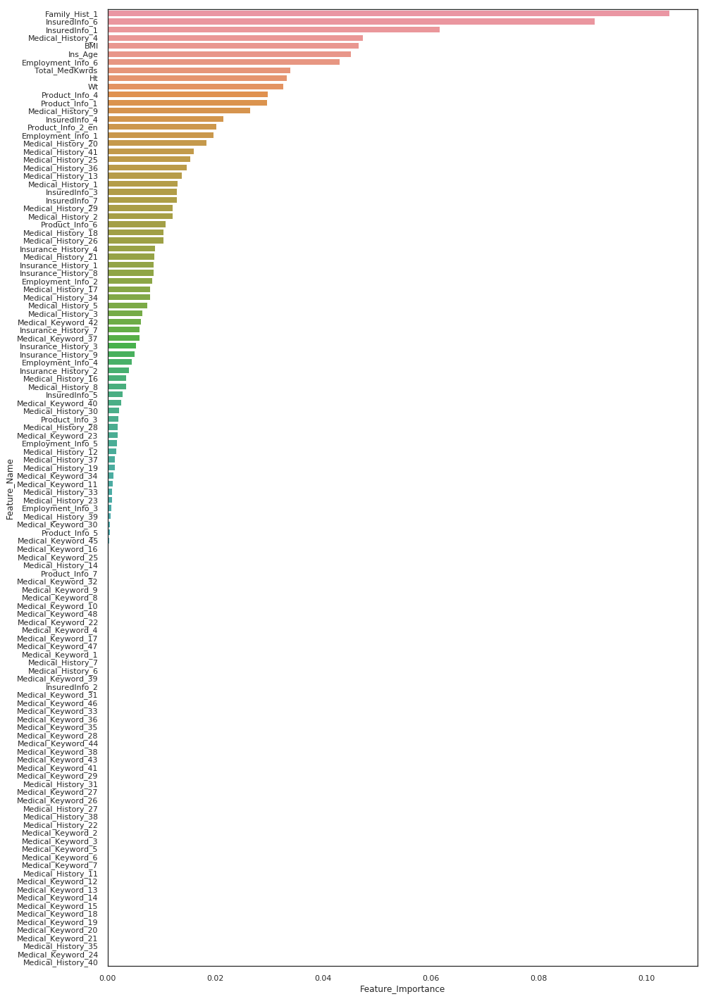

In [49]:
# Train
# importances = rf_random.best_estimator_.feature_importances_
importances = random_forest_high_p.feature_importances_

data={'Feature_Name':names,
      'Feature_Importance': importances
     }

feature_df=pd.DataFrame(data)

feature_df.sort_values(by=['Feature_Importance'],ascending=False,inplace=True)

fig, ax = plt.subplots(figsize=(15,25))
sns.barplot(data=feature_df,y='Feature_Name',x='Feature_Importance',)

# Visualizing Random forest tree diagram

Steps involved in creation of tree:
1. ** Create a model train**
2. **Export Tree as .dot File**: This makes use of the export_graphviz function in Scikit-Learn. There are many parameters here that control the look and information displayed. Take a look at the documentation for specifics.
3. **Convert dot to png using a system command**: running system commands in Python can be handy for carrying out simple tasks. This requires installation of graphviz which includes the dot utility. For the complete options for conversion, take a look at the documentation.
4. **Visualize**: the best visualizations appear in the Jupyter Notebook. (Equivalently you can use matplotlib to show images).


In [50]:
estimator=random_forest_high_p
# estimator.fit(X_train,y_train)
rf_estimator=estimator.estimators_[5]

from sklearn.tree import export_graphviz

export_graphviz(rf_estimator, out_file='tree.dot', 
                feature_names =names,
                class_names = 'Response',
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

## Model 2: XGBoost Classifier

In [51]:
xgbc_model= XGBClassifier()
xgbc_model.fit(X_train,y_train)
xgbc_model

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0,
              learning_rate=0.1, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=1, verbosity=1)

In [52]:
#evalutate the base model
xgbc_base_recall,xgbc_base_precison,xgbc_base_f1,xgbc_base_auc,xgbc_base_train_accuracy,xgbc_base_test_accuracy= evaluate(xgbc_model,X_train,y_train,np.array(X_valid),np.array(y_valid))

Train Accuracy: 0.866
Test Accuracy: 0.821
Precision Score: 0.706
Recall Score: 0.778
F1 Score: 0.74
AUC: 0.81
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.89      0.84      0.86     11972
           1       0.71      0.78      0.74      5843

    accuracy                           0.82     17815
   macro avg       0.80      0.81      0.80     17815
weighted avg       0.83      0.82      0.82     17815

==============Confusion Matrix=============================
[[10078  1894]
 [ 1297  4546]]


In [53]:
#list of parameters that can be tuned in xgbc model
pprint(xgbc_model.get_params())

{'base_score': 0.5,
 'booster': 'gbtree',
 'colsample_bylevel': 1,
 'colsample_bynode': 1,
 'colsample_bytree': 1,
 'gamma': 0,
 'learning_rate': 0.1,
 'max_delta_step': 0,
 'max_depth': 3,
 'min_child_weight': 1,
 'missing': None,
 'n_estimators': 100,
 'n_jobs': 1,
 'nthread': None,
 'objective': 'binary:logistic',
 'random_state': 0,
 'reg_alpha': 0,
 'reg_lambda': 1,
 'scale_pos_weight': 1,
 'seed': None,
 'silent': None,
 'subsample': 1,
 'verbosity': 1}


In [54]:
# XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
#               colsample_bynode=1, colsample_bytree=1, gamma=0,
#               learning_rate=0.1, max_delta_step=0, max_depth=3,
#               min_child_weight=1, missing=None, n_estimators=100, n_jobs=1,
#               nthread=None, objective='binary:logistic', random_state=0,
#               reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
#               silent=None, subsample=1, verbosity=1)


# ### Parameters to tune based on above results:
# 1. n_estimators: max_depth is limited to 3. As we will control the depth , we could increase the the number of estimators to see any enhancment
# 2. max_depth: Currently 3, we can try to increase it
# 3. colsample_bytree:  currently tree will be build till there 1 value in leaf.Condition for overfitting
# 4. min_child_weight: Instead of building RF on whole dataset, we will take random sets and train indidvidual trees
# 4. Min_samples_split: To avoid overfitting we will only split if certain number of records are present in node
    
# Lets create the parameter grid for tunning XGBClassifier

xgbc_grid = {'n_estimators': np.arange(110,200,40),
              'learning_rate': np.arange(0.01, 0.1,0.03),
              'subsample': [0.6],
              'max_depth': np.arange(4,10,3),
              'colsample_bytree': np.arange(0.3, 0.6,0.3),
              'min_child_weight': [1, 2, 3],
             'n_jobs':[-1]
             }
pprint(xgbc_grid)


{'colsample_bytree': array([0.3]),
 'learning_rate': array([0.01, 0.04, 0.07, 0.1 ]),
 'max_depth': array([4, 7]),
 'min_child_weight': [1, 2, 3],
 'n_estimators': array([110, 150, 190]),
 'n_jobs': [-1],
 'subsample': [0.6]}


In [55]:
random_xgbc=GridSearchCV(estimator = XGBClassifier(),
                         param_grid=xgbc_grid,
                         #n_iter = 50,
                         cv = 2,
                         verbose=2,
                         scoring='precision',
                         #random_state=42,
                         n_jobs = -1)# Fit the random search model

random_xgbc.fit(X_train, y_train)

Fitting 2 folds for each of 72 candidates, totalling 144 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 4 concurrent workers.
/opt/conda/lib/python3.6/site-packages/joblib/externals/loky/process_executor.py:706: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  "timeout or by a memory leak.", UserWarning
[Parallel(n_jobs=-1)]: Done  33 tasks      | elapsed: 31.9min
[Parallel(n_jobs=-1)]: Done 144 out of 144 | elapsed: 127.9min finished


GridSearchCV(cv=2, error_score='raise-deprecating',
             estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                                     colsample_bylevel=1, colsample_bynode=1,
                                     colsample_bytree=1, gamma=0,
                                     learning_rate=0.1, max_delta_step=0,
                                     max_depth=3, min_child_weight=1,
                                     missing=None, n_estimators=100, n_jobs=1,
                                     nthread=None, objective='binary:logistic',
                                     random_state=0, reg_alpha=0, reg_l...
                                     scale_pos_weight=1, seed=None, silent=None,
                                     subsample=1, verbosity=1),
             iid='warn', n_jobs=-1,
             param_grid={'colsample_bytree': array([0.3]),
                         'learning_rate': array([0.01, 0.04, 0.07, 0.1 ]),
                         'max_depth': ar

In [56]:
random_xgbc.best_estimator_

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.3, gamma=0,
              learning_rate=0.09999999999999999, max_delta_step=0, max_depth=7,
              min_child_weight=1, missing=None, n_estimators=190, n_jobs=-1,
              nthread=None, objective='binary:logistic', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
              silent=None, subsample=0.6, verbosity=1)

In [57]:
print("\n ==========================Base Model==========================")
#model=RandomForestClassifier(random_state=1)
xgbc_model.fit(X_train,y_train)
xgbc_base_recall,xgbc_base_precison,xgbc_base_f1,xgbc_base_auc,xgbc_base_train_accuracy,xgbc_base_test_accuracy= evaluate(xgbc_model,X_train,y_train,np.array(X_valid),np.array(y_valid))


print("\n ==========================Tuned Model==========================")
best_random_xgbc = random_xgbc.best_estimator_
xgbc_randomcv_recall,xgbc_randomcv_precison,xgbc_randomcv_f1,xgbc_randomcv_auc,xgbc_randomcv_train_accuracy,xgbc_randomcv_test_accuracy = evaluate(best_random_xgbc,X_train,y_train,np.array(X_valid),np.array(y_valid))
                                                                                                                                                   
print('RandomSearchCV Improvement for XGBC in Recall of {:0.2f}%.'.format( 100 * (xgbc_randomcv_recall - xgbc_base_recall) / xgbc_base_recall))
print('RandomSearchCV Improvement for XGBC in Precision of {:0.2f}%.'.format( 100 * (xgbc_randomcv_precison - xgbc_base_precison) / xgbc_base_precison))
print('RandomSearchCV Improvement for XGBC in F1 Score of {:0.2f}%.'.format( 100 * (xgbc_randomcv_f1 - xgbc_base_f1) / xgbc_base_f1))
print('RandomSearchCV Improvement in for XGBC AUC of {:0.2f}%.'.format( 100 * (xgbc_randomcv_auc - xgbc_base_auc) / xgbc_base_auc))
print('RandomSearchCV Improvement in for XGBC Train Accuracy of {:0.2f}%.'.format( 100 * (xgbc_randomcv_train_accuracy - xgbc_base_train_accuracy) / xgbc_base_train_accuracy))
print('RandomSearchCV Improvement in for XGBC Test Accuracy of {:0.2f}%.'.format( 100 * (xgbc_randomcv_test_accuracy - xgbc_base_test_accuracy) / xgbc_base_test_accuracy))


 ==========================Base Model==========================
Train Accuracy: 0.866
Test Accuracy: 0.821
Precision Score: 0.706
Recall Score: 0.778
F1 Score: 0.74
AUC: 0.81
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.89      0.84      0.86     11972
           1       0.71      0.78      0.74      5843

    accuracy                           0.82     17815
   macro avg       0.80      0.81      0.80     17815
weighted avg       0.83      0.82      0.82     17815

==============Confusion Matrix=============================
[[10078  1894]
 [ 1297  4546]]

 ==========================Tuned Model==========================
Train Accuracy: 0.899
Test Accuracy: 0.829
Precision Score: 0.732
Recall Score: 0.756
F1 Score: 0.744
AUC: 0.811
==============Classification Report=============================
              precision    recall  f1-score   support

           0       0.88      0.86      0.8

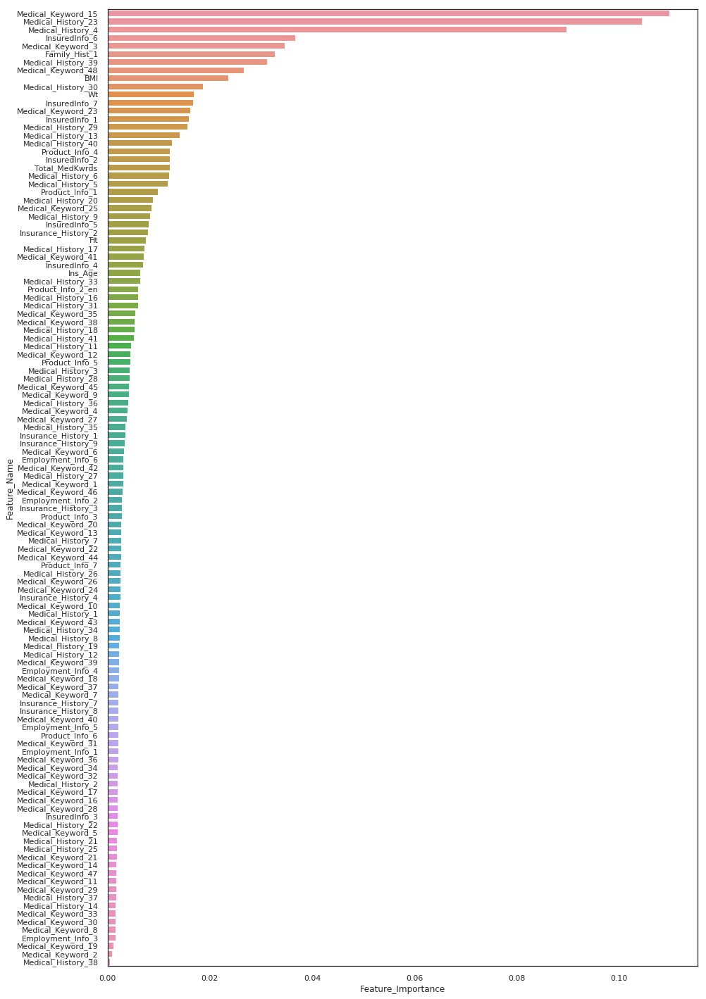

In [58]:
# Train
importances = random_xgbc.best_estimator_.feature_importances_

data={'Feature_Name':names,
      'Feature_Importance': importances
     }

feature_df=pd.DataFrame(data)

feature_df.sort_values(by=['Feature_Importance'],ascending=False,inplace=True)

fig, ax = plt.subplots(figsize=(15,25))
sns.barplot(data=feature_df,y='Feature_Name',x='Feature_Importance',)